In [1]:
import os
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.font_manager
import seaborn as sns
import anndata
import scvi
import scanpy as sc
import re

Global seed set to 0
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
data_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/data/"
plot_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/"
clus_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/clustering/"
newdata_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/new_analysis/data/"


In [3]:
##load data
adata_list = {
    "NK": sc.read_h5ad(newdata_dir+"NK_postQC_leiden.h5ad"),
    "CD8":sc.read_h5ad(newdata_dir+"CD8_postQC_leiden.h5ad"),
    "CD4":sc.read_h5ad(newdata_dir+"CD4_postQC_leiden.h5ad"),
    "Myeloid_Plt":sc.read_h5ad(newdata_dir+"Myeloid_Plt_postQC_leiden.h5ad"),
    "Bcells":sc.read_h5ad(newdata_dir+"Bcells_postQC_leiden.h5ad"),
}


## NK annotation

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


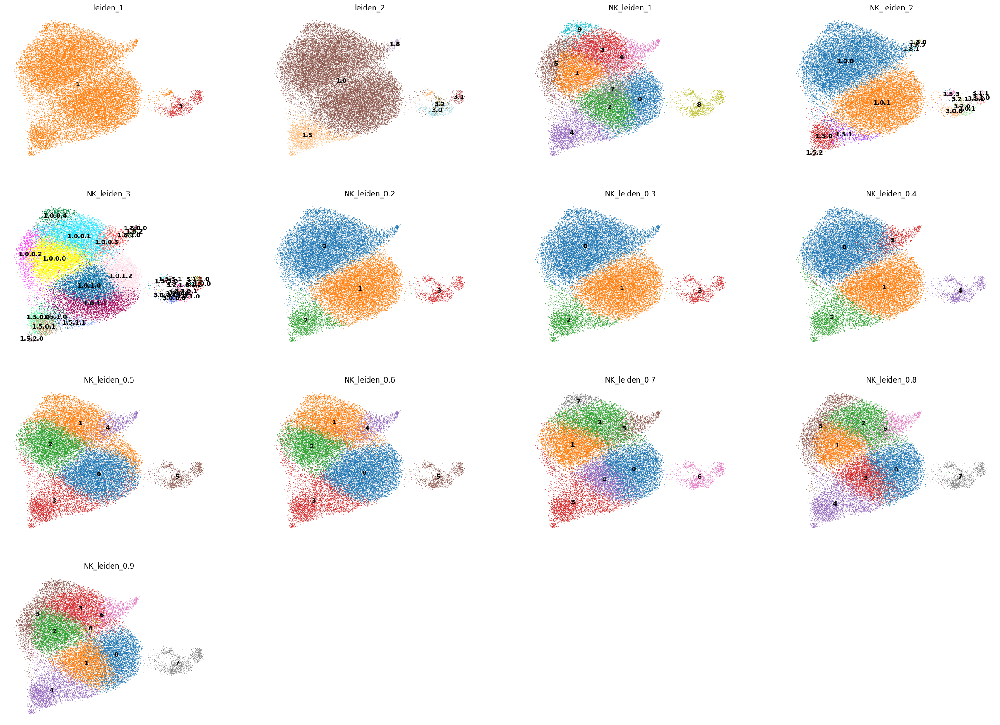

<Figure size 640x480 with 0 Axes>

In [4]:
##Check leiden vs new clus
leiden_clus = [col for col in adata_list["NK"].obs.columns if 'leiden' in col]
##plot
with plt.rc_context():
    sc.pl.umap(
        adata_list["NK"],
        color=leiden_clus,
        #groups = ["Healthy", "Healthy_azimuth"],
        frameon=False,
        legend_loc='on data',
        #     legend_fontoutline=1,
        #size=5,
    )
    plt.savefig(plot_dir+"NK_leiden_all.png", bbox_inches="tight")


In [5]:
## find markers for NK_leiden_0.8
##rank genes by group then subset top 5
adata_list["NK"].X = adata_list["NK"].layers["counts"].copy()
sc.pp.normalize_total(adata_list["NK"], target_sum=1e4)
sc.pp.log1p(adata_list["NK"])
    
sc.tl.rank_genes_groups(adata_list["NK"], 'NK_leiden_0.8')
sc.tl.dendrogram(adata_list["NK"], groupby='NK_leiden_0.8', use_rep = "X_scVI")
top10 = pd.DataFrame(adata_list["NK"].uns['rank_genes_groups']['names']).head(10)


/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


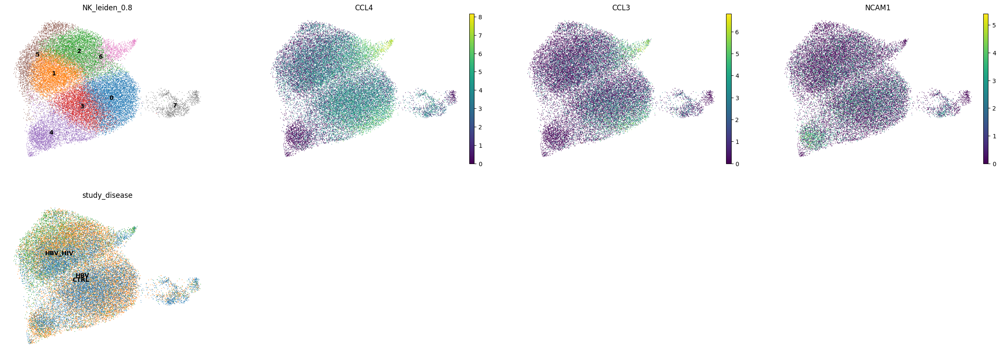

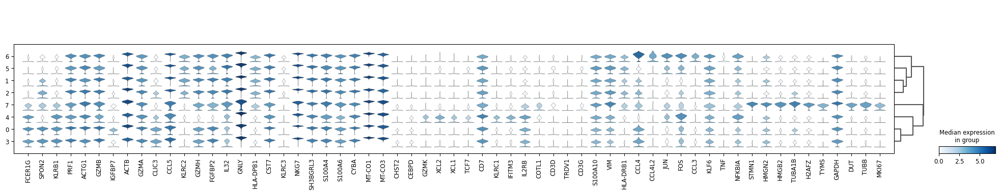

In [6]:
sc.pl.umap(
    adata_list["NK"],
    color=['NK_leiden_0.8','CCL4', 'CCL3', 'NCAM1', 'study_disease'],
    frameon=False,
    legend_loc='on data',
)
plt.show()

sc.pl.stacked_violin(adata_list["NK"], pd.unique(top10.values.ravel('K')), groupby='NK_leiden_0.8', dendrogram=True)
plt.show()


In [8]:
adata_list["NK"].obs["NK.annotation.l1"] = adata_list["NK"].obs["NK_leiden_0.8"].astype("str").copy()
adata_list["NK"].obs["NK.annotation.l1"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['6'])]='NK.Adaptive.CCL4.CCL3'
adata_list["NK"].obs["NK.annotation.l1"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['5'])]='NK.Adaptive'
adata_list["NK"].obs["NK.annotation.l1"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['1'])]='NK.Adaptive'
adata_list["NK"].obs["NK.annotation.l1"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['2'])]='NK.Adaptive'
adata_list["NK"].obs["NK.annotation.l1"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['7'])]='NK.Prolifering'
adata_list["NK"].obs["NK.annotation.l1"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['4'])]='NK.CD56bright'
adata_list["NK"].obs["NK.annotation.l1"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['0'])]='NK.Mature'
adata_list["NK"].obs["NK.annotation.l1"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['3'])]='NK.Mature'

##Higher resolution
adata_list["NK"].obs["NK.annotation.l2"] = adata_list["NK"].obs["NK_leiden_0.8"].astype("str").copy()
adata_list["NK"].obs["NK.annotation.l2"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['6'])]='NK.Adaptive.CCL4.CCL3'
adata_list["NK"].obs["NK.annotation.l2"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['5'])]='NK.Adaptive.SPON2neg'
adata_list["NK"].obs["NK.annotation.l2"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['1'])]='NK.Adaptive.SPON2'
adata_list["NK"].obs["NK.annotation.l2"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['2'])]='NK.Adaptive.SPON2'
adata_list["NK"].obs["NK.annotation.l2"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['7'])]='NK.Prolifering'
adata_list["NK"].obs["NK.annotation.l2"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['4'])]='NK.CD56bright'
adata_list["NK"].obs["NK.annotation.l2"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['0'])]='NK.Mature'
adata_list["NK"].obs["NK.annotation.l2"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['3'])]='NK.Mature'


/tmp/ipykernel_11821/1513338250.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_list["NK"].obs["NK.annotation.l1"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['6'])]='NK.Adaptive.CCL4.CCL3'
/tmp/ipykernel_11821/1513338250.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_list["NK"].obs["NK.annotation.l1"][adata_list["NK"].obs["NK_leiden_0.8"].isin(['5'])]='NK.Adaptive'
/tmp/ipykernel_11821/1513338250.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


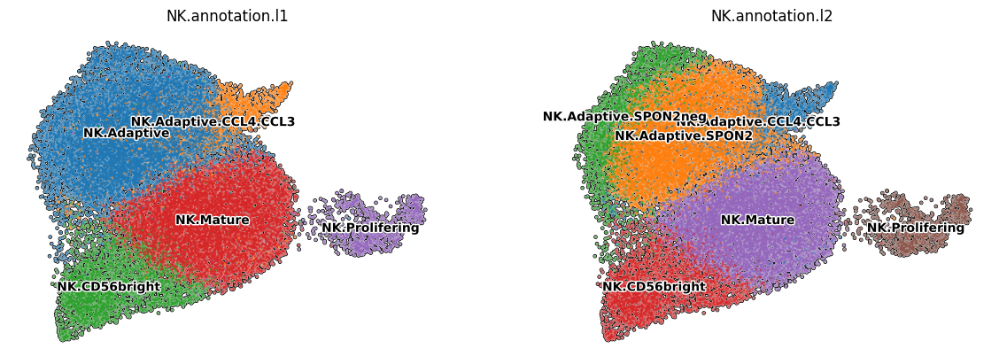

In [9]:
sc.pl.umap(
    adata_list["NK"],
    color=['NK.annotation.l1', 'NK.annotation.l2'],
    frameon=False,
    legend_loc='on data',
    legend_fontoutline = 2,
    add_outline = True,
    size=15
)

plt.show()

## B cell annotation

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


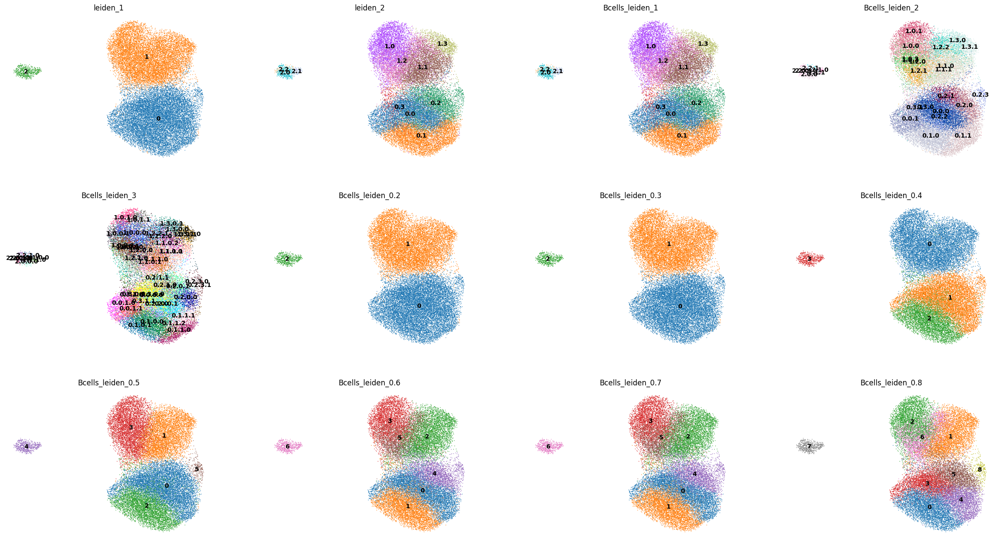

In [10]:
##Check leiden vs new clus
leiden_clus = [col for col in adata_list["Bcells"].obs.columns if 'leiden' in col]
##plot
with plt.rc_context():
    sc.pl.umap(
        adata_list["Bcells"],
        color=leiden_clus,
        #groups = ["Healthy", "Healthy_azimuth"],
        frameon=False,
        legend_loc='on data',
        #     legend_fontoutline=1,
        #size=5,
    )
    plt.savefig(plot_dir+"Bcells_leiden_all.png", bbox_inches="tight")

In [11]:
## find markers for Bcells_leiden_1
##rank genes by group then subset top 5
adata_list["Bcells"].X = adata_list["Bcells"].layers["counts"].copy()
sc.pp.normalize_total(adata_list["Bcells"], target_sum=1e4)
sc.pp.log1p(adata_list["Bcells"])
    
sc.tl.rank_genes_groups(adata_list["Bcells"], 'Bcells_leiden_1')
sc.tl.dendrogram(adata_list["Bcells"], groupby='Bcells_leiden_1', use_rep = "X_scVI")
top10 = pd.DataFrame(adata_list["Bcells"].uns['rank_genes_groups']['names']).head(10)


<Figure size 640x480 with 0 Axes>

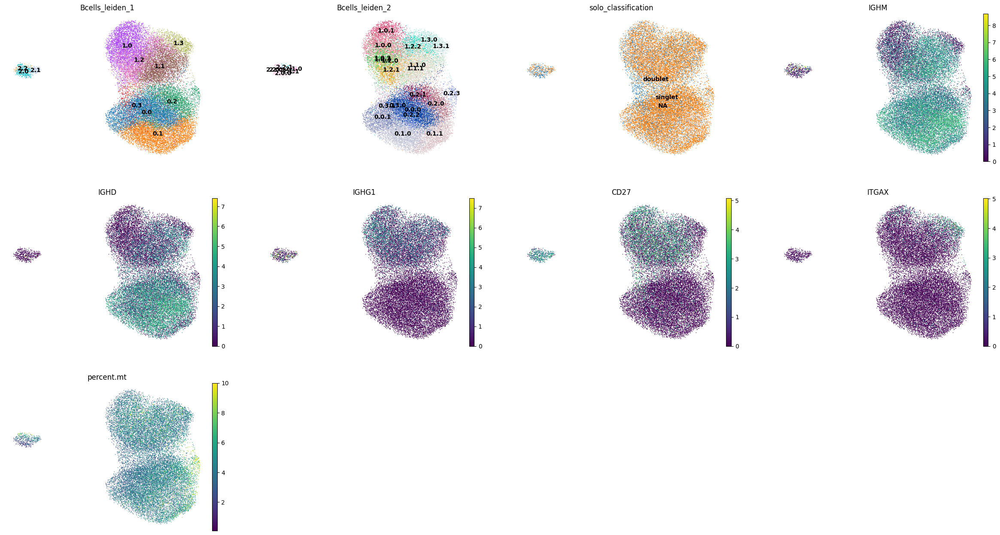

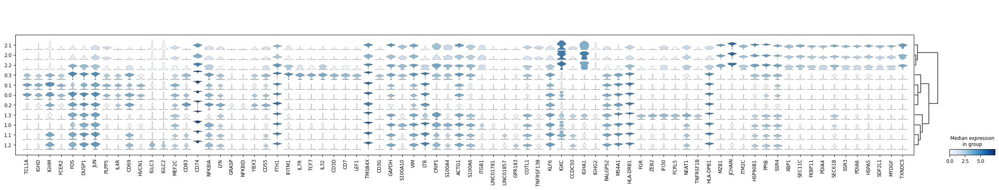

In [12]:
sc.pl.umap(
    adata_list["Bcells"],
    color=['Bcells_leiden_1','Bcells_leiden_2','solo_classification','IGHM', 'IGHD','IGHG1', 'CD27', 'ITGAX', 'percent.mt'],
    #groups=["2.2"],
    frameon=False,
    legend_loc='on data',
)
plt.show()

sc.pl.stacked_violin(adata_list["Bcells"], pd.unique(top10.values.ravel('K')), groupby='Bcells_leiden_1', dendrogram=True)
plt.show()


In [13]:
adata_list["Bcells"].obs["Bcells.annotation.l1"] = adata_list["Bcells"].obs["Bcells_leiden_1"].astype("str").copy()
adata_list["Bcells"].obs["Bcells.annotation.l1"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['2.0','2.1'])]='B.Plasmablast'
adata_list["Bcells"].obs["Bcells.annotation.l1"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['0.3','2.2'])]='B.Doublet'
adata_list["Bcells"].obs["Bcells.annotation.l1"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['0.1', '0.0', '0.2'])]='B.Naive'
adata_list["Bcells"].obs["Bcells.annotation.l1"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['1.0'])]='B.CSW.Memory'
adata_list["Bcells"].obs["Bcells.annotation.l1"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['1.2','1.1'])]='B.UNSW.Memory'
adata_list["Bcells"].obs["Bcells.annotation.l1"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['1.3'])]='B.DN.ITGAX'

##Higher resolution
adata_list["Bcells"].obs["Bcells.annotation.l2"] = adata_list["Bcells"].obs["Bcells_leiden_2"].astype("str").copy()
adata_list["Bcells"].obs["Bcells.annotation.l2"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['2.0','2.1'])]='B.Plasmablast'
adata_list["Bcells"].obs["Bcells.annotation.l2"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['0.3','2.2'])]='B.Doublet'
adata_list["Bcells"].obs["Bcells.annotation.l2"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['0.1', '0.0'])]='B.Naive'
adata_list["Bcells"].obs["Bcells.annotation.l2"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['0.2'])]='B.Naive.TCLA1_low'
adata_list["Bcells"].obs["Bcells.annotation.l2"][adata_list["Bcells"].obs["Bcells_leiden_2"].isin(['0.2.3'])]='B.Naive.Mitohi'
adata_list["Bcells"].obs["Bcells.annotation.l2"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['1.0'])]='B.CSW.Memory'
adata_list["Bcells"].obs["Bcells.annotation.l2"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['1.2','1.1'])]='B.UNSW.Memory'
adata_list["Bcells"].obs["Bcells.annotation.l2"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['1.3'])]='B.DN.ITGAX'




/tmp/ipykernel_11821/185373452.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_list["Bcells"].obs["Bcells.annotation.l1"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['2.0','2.1'])]='B.Plasmablast'
/tmp/ipykernel_11821/185373452.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_list["Bcells"].obs["Bcells.annotation.l1"][adata_list["Bcells"].obs["Bcells_leiden_1"].isin(['0.3','2.2'])]='B.Doublet'
/tmp/ipykernel_11821/185373452.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs

In [14]:
adata_list["Bcells"] = adata_list["Bcells"][~adata_list["Bcells"].obs["Bcells.annotation.l1"].isin(["B.Doublet"])].copy()

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


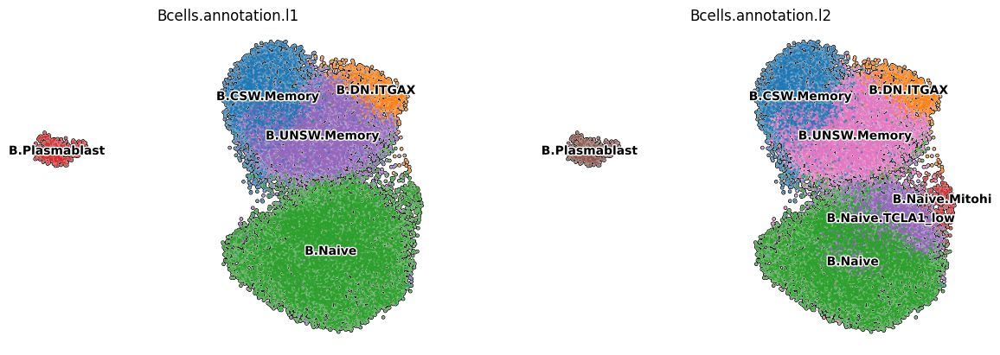

In [15]:
sc.pl.umap(
    adata_list["Bcells"],
    color=['Bcells.annotation.l1', 'Bcells.annotation.l2'],
    frameon=False,
    legend_loc='on data',
    legend_fontoutline = 2,
    add_outline = True,
    size=15
)

plt.show()

## CD8 annotation

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


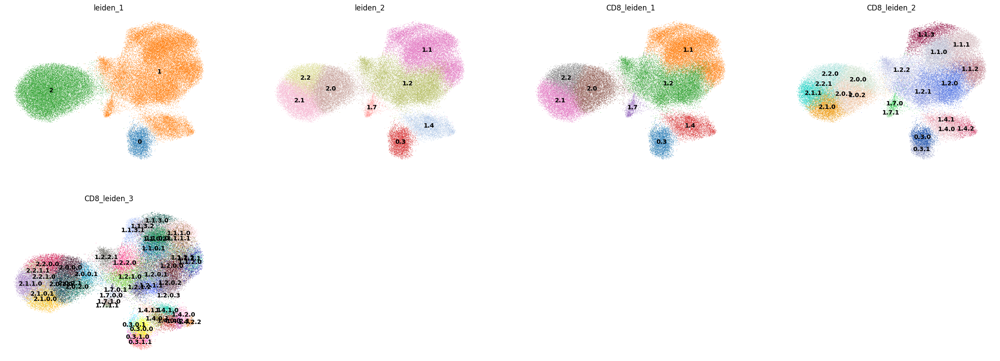

In [16]:
##Check leiden vs new clus
leiden_clus = [col for col in adata_list["CD8"].obs.columns if 'leiden' in col]
##plot
with plt.rc_context():
    sc.pl.umap(
        adata_list["CD8"],
        color=leiden_clus,
        #groups = ["Healthy", "Healthy_azimuth"],
        frameon=False,
        legend_loc='on data',
        #     legend_fontoutline=1,
        #size=5,
    )
    plt.savefig(plot_dir+"CD8_leiden_all.png", bbox_inches="tight")

In [17]:
## find markers for CD8_leiden_2
##rank genes by group then subset top 5
adata_list["CD8"].X = adata_list["CD8"].layers["counts"].copy()
sc.pp.normalize_total(adata_list["CD8"], target_sum=1e4)
sc.pp.log1p(adata_list["CD8"])
    
sc.tl.rank_genes_groups(adata_list["CD8"], 'CD8_leiden_2')
sc.tl.dendrogram(adata_list["CD8"], groupby='CD8_leiden_2', use_rep = "X_scVI")
top10 = pd.DataFrame(adata_list["CD8"].uns['rank_genes_groups']['names']).head(10)


/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9

<Figure size 640x480 with 0 Axes>

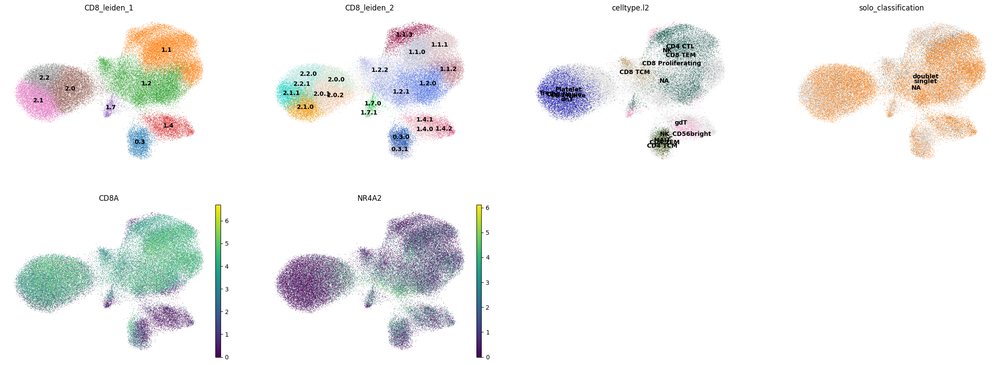

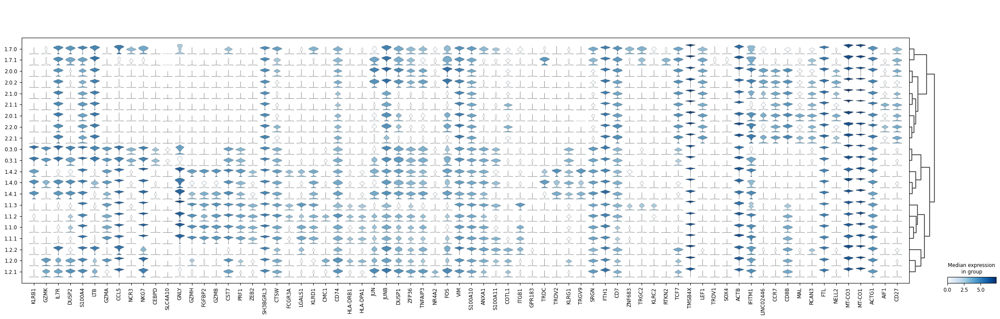

In [18]:
sc.pl.umap(
    adata_list["CD8"],
    color=['CD8_leiden_1','CD8_leiden_2','celltype.l2','solo_classification', 'CD8A','NR4A2'],
    #groups=["2.2"],
    frameon=False,
    legend_loc='on data',
)
plt.show()

sc.pl.stacked_violin(adata_list["CD8"], pd.unique(top10.values.ravel('K')), groupby='CD8_leiden_2', dendrogram=True)
plt.show()

In [19]:
adata_list["CD8"].obs["CD8.annotation.l1"] = adata_list["CD8"].obs["CD8_leiden_2"].astype("str").copy()
adata_list["CD8"].obs["CD8.annotation.l1"][adata_list["CD8"].obs["CD8_leiden_1"].isin(['2.0','2.1','2.2'])]='CD8.Naive'
adata_list["CD8"].obs["CD8.annotation.l1"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.2.2'])]='CD8.TCM'
adata_list["CD8"].obs["CD8.annotation.l1"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.2.1'])]='CD8.TEM'
adata_list["CD8"].obs["CD8.annotation.l1"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.2.0'])]='CD8.TEM'
adata_list["CD8"].obs["CD8.annotation.l1"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.1.2','1.1.0','1.1.3', '1.1.1'])]='CD8.TEMRA'
adata_list["CD8"].obs["CD8.annotation.l1"][adata_list["CD8"].obs["CD8_leiden_1"].isin(['1.4'])]='gdT'
adata_list["CD8"].obs["CD8.annotation.l1"][adata_list["CD8"].obs["CD8_leiden_1"].isin(['0.3'])]='MAIT'
adata_list["CD8"].obs["CD8.annotation.l1"][adata_list["CD8"].obs["CD8_leiden_1"].isin(['1.7'])]='MPECs'

##Higher resolution
adata_list["CD8"].obs["CD8.annotation.l2"] = adata_list["CD8"].obs["CD8_leiden_2"].astype("str").copy()
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_1"].isin(['2.0','2.1','2.2'])]='CD8.Naive'
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.2.2'])]='CD8.TCM'
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.2.1'])]='CD8.TEM.NF4A2'
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.2.0'])]='CD8.TEM'
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.1.2'])]='CD8.TEMRA.CMC1'
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.1.3'])]='CD8.TEMRA.FCGR3A'
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.1.1', '1.1.0'])]='CD8.TEMRA.FCGR3Alow'
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_1"].isin(['0.3'])]='MAIT'
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_1"].isin(['1.4'])]='gdT'
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.7.1'])]='gdT.MPEC'
adata_list["CD8"].obs["CD8.annotation.l2"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.7.0'])]='CD8.TEM.MPEC'



/tmp/ipykernel_11821/515252645.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_list["CD8"].obs["CD8.annotation.l1"][adata_list["CD8"].obs["CD8_leiden_1"].isin(['2.0','2.1','2.2'])]='CD8.Naive'
/tmp/ipykernel_11821/515252645.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_list["CD8"].obs["CD8.annotation.l1"][adata_list["CD8"].obs["CD8_leiden_2"].isin(['1.2.2'])]='CD8.TCM'
/tmp/ipykernel_11821/515252645.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


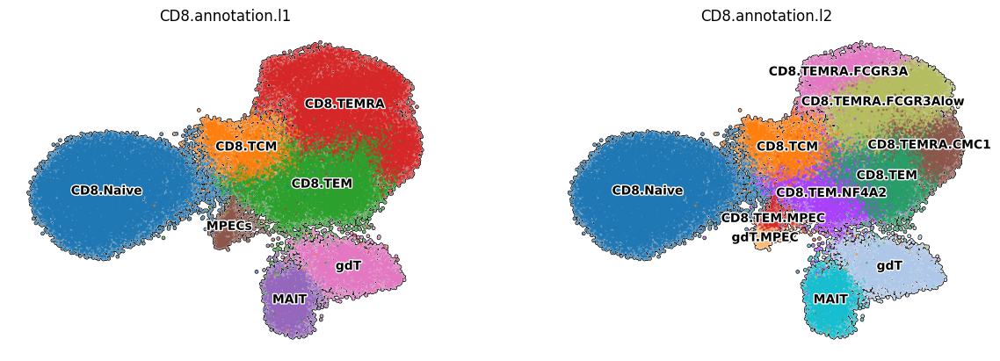

In [20]:
sc.pl.umap(
    adata_list["CD8"],
    color=['CD8.annotation.l1', 'CD8.annotation.l2'],
    frameon=False,
    legend_loc='on data',
    legend_fontoutline = 2,
    add_outline = True,
    size=15
)

plt.show()

## CD4 annotation

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


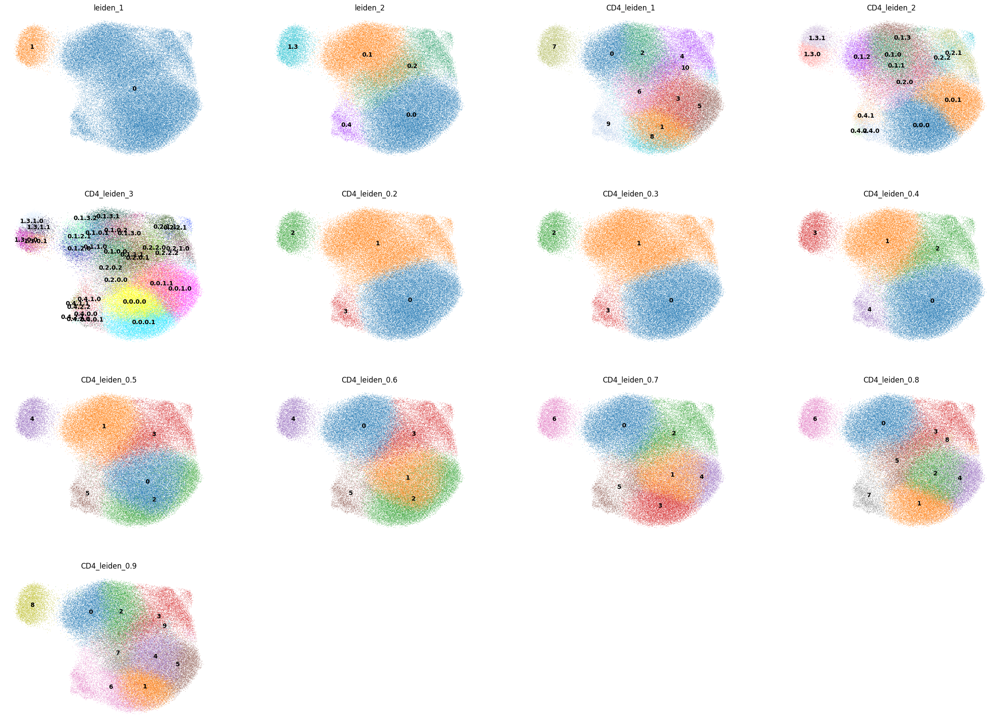

In [21]:
##Check leiden vs new clus
leiden_clus = [col for col in adata_list["CD4"].obs.columns if 'leiden' in col]
##plot
with plt.rc_context():
    sc.pl.umap(
        adata_list["CD4"],
        color=leiden_clus,
        #groups = ["Healthy", "Healthy_azimuth"],
        frameon=False,
        legend_loc='on data',
        #     legend_fontoutline=1,
        #size=5,
    )
    plt.savefig(plot_dir+"CD4_leiden_all.png", bbox_inches="tight")

In [22]:
## find markers for CD4_leiden_2
##rank genes by group then subset top 5
adata_list["CD4"].X = adata_list["CD4"].layers["counts"].copy()
sc.pp.normalize_total(adata_list["CD4"], target_sum=1e4)
sc.pp.log1p(adata_list["CD4"])
    
sc.tl.rank_genes_groups(adata_list["CD4"], 'CD4_leiden_2')
sc.tl.dendrogram(adata_list["CD4"], groupby='CD4_leiden_2', use_rep = "X_scVI")
top10 = pd.DataFrame(adata_list["CD4"].uns['rank_genes_groups']['names']).head(10)


<Figure size 640x480 with 0 Axes>

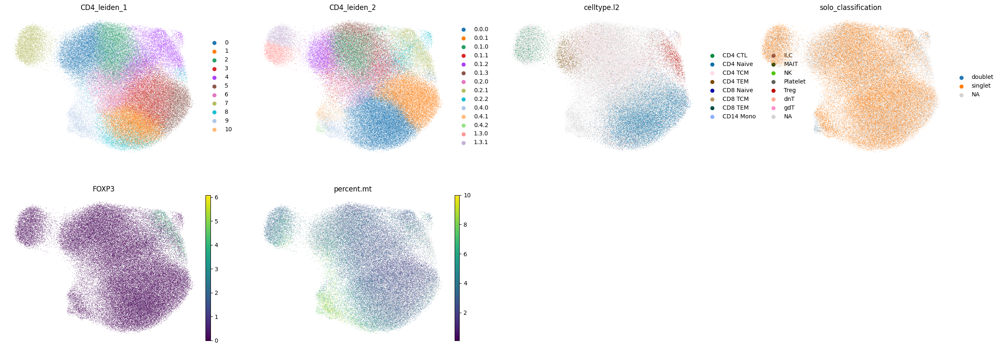

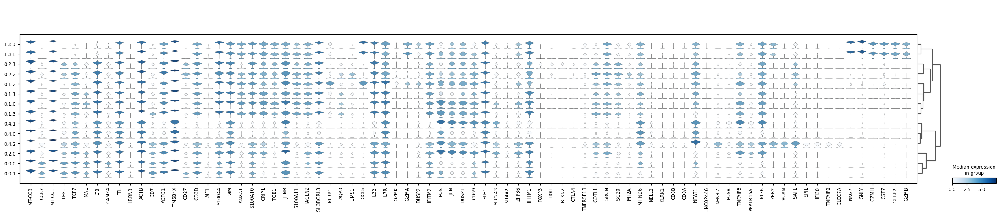

In [23]:
sc.pl.umap(
    adata_list["CD4"],
    color=['CD4_leiden_1','CD4_leiden_2','celltype.l2','solo_classification','FOXP3', 'percent.mt'],
    #groups=["dnT"],
    frameon=False,
    #legend_loc='on data',
)
plt.show()

sc.pl.stacked_violin(adata_list["CD4"], pd.unique(top10.values.ravel('K')), groupby='CD4_leiden_2', dendrogram=True)
plt.show()

In [24]:
adata_list["CD4"].obs["CD4.annotation.l1"] = adata_list["CD4"].obs["CD4_leiden_2"].astype("str").copy()
adata_list["CD4"].obs["CD4.annotation.l1"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['1.3.1','1.3.0'])]='CD4.TEMRA'
adata_list["CD4"].obs["CD4.annotation.l1"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.1.2'])]='CD4.TEM'
adata_list["CD4"].obs["CD4.annotation.l1"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.1.0','0.1.1','0.1.3', '0.2.0'])]='CD4.TCM'
adata_list["CD4"].obs["CD4.annotation.l1"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.0.1','0.0.0'])]='CD4.Naive'

adata_list["CD4"].obs["CD4.annotation.l1"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.4.0','0.4.1'])]='CD4.Mitohi'
adata_list["CD4"].obs["CD4.annotation.l1"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.4.2'])]='CD4.Doublet'
adata_list["CD4"].obs["CD4.annotation.l1"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.2.2'])]='dnT'
adata_list["CD4"].obs["CD4.annotation.l1"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.2.1'])]='CD4.Treg'


##Higher resolution
adata_list["CD4"].obs["CD4.annotation.l2"] = adata_list["CD4"].obs["CD4_leiden_2"].astype("str").copy()
adata_list["CD4"].obs["CD4.annotation.l2"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['1.3.1','1.3.0'])]='CD4.TEMRA'
adata_list["CD4"].obs["CD4.annotation.l2"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.1.2'])]='CD4.TEM'
adata_list["CD4"].obs["CD4.annotation.l2"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.1.0','0.1.1','0.1.3', '0.2.0'])]='CD4.TCM'
adata_list["CD4"].obs["CD4.annotation.l2"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.0.1','0.0.0'])]='CD4.Naive'
adata_list["CD4"].obs["CD4.annotation.l2"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.4.0','0.4.1'])]='CD4.Mitohi'
adata_list["CD4"].obs["CD4.annotation.l2"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.4.2'])]='CD4.Doublet'
adata_list["CD4"].obs["CD4.annotation.l2"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.2.2'])]='dnT'
adata_list["CD4"].obs["CD4.annotation.l2"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.2.1'])]='CD4.Treg'


/tmp/ipykernel_11821/307477985.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_list["CD4"].obs["CD4.annotation.l1"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['1.3.1','1.3.0'])]='CD4.TEMRA'
/tmp/ipykernel_11821/307477985.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_list["CD4"].obs["CD4.annotation.l1"][adata_list["CD4"].obs["CD4_leiden_2"].isin(['0.1.2'])]='CD4.TEM'
/tmp/ipykernel_11821/307477985.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.ht

In [25]:
adata_list["CD4"] = adata_list["CD4"][~adata_list["CD4"].obs["CD4.annotation.l1"].isin(["CD4.Doublet"])].copy()

In [26]:
adata_list["CD4"].X = adata_list["CD4"].layers["counts"].copy()
sc.pp.normalize_total(adata_list["CD4"], target_sum=1e4)
sc.pp.log1p(adata_list["CD4"])
    
sc.tl.rank_genes_groups(adata_list["CD4"], 'CD4.annotation.l1')
sc.tl.dendrogram(adata_list["CD4"], groupby='CD4.annotation.l1', use_rep = "X_scVI")
top10 = pd.DataFrame(adata_list["CD4"].uns['rank_genes_groups']['names']).head(10)


/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


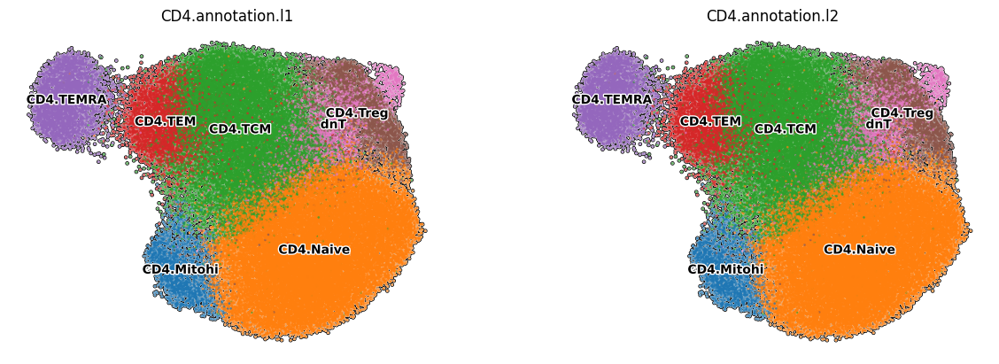

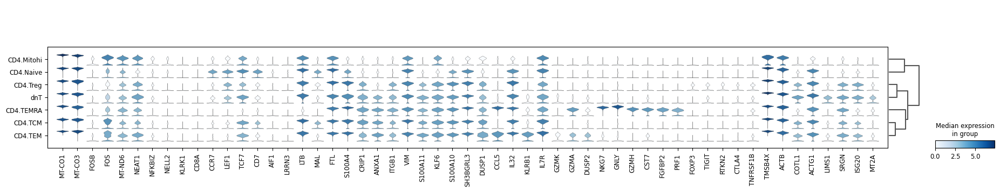

In [27]:
sc.pl.umap(
    adata_list["CD4"],
    color=['CD4.annotation.l1', 'CD4.annotation.l2'],
    frameon=False,
    legend_loc='on data',
    legend_fontoutline = 2,
    add_outline = True,
    size=15
)

plt.show()

sc.pl.stacked_violin(adata_list["CD4"], pd.unique(top10.values.ravel('K')), groupby='CD4.annotation.l1', dendrogram=True)
plt.show()


## Myeloid annotation

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


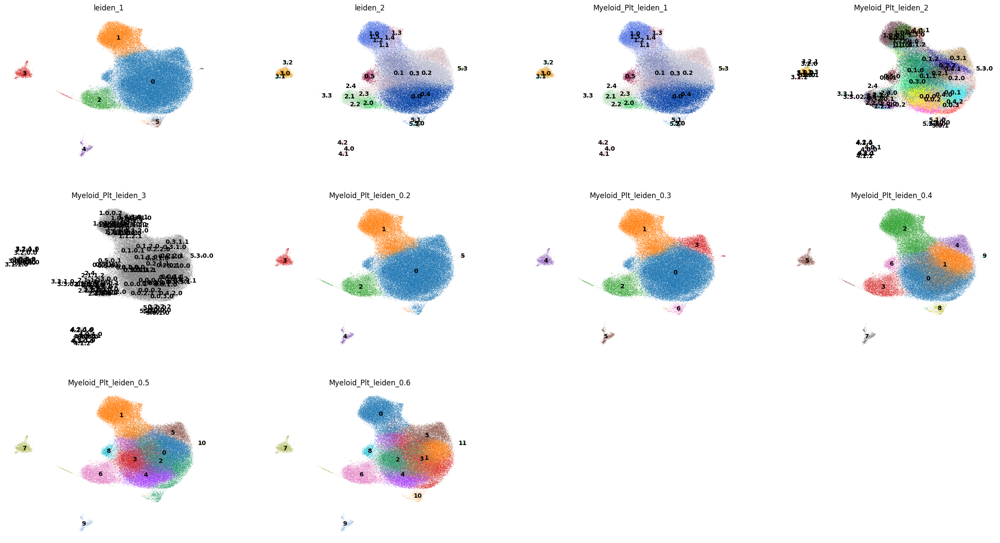

In [28]:
##Check leiden vs new clus
leiden_clus = [col for col in adata_list["Myeloid_Plt"].obs.columns if 'leiden' in col]
##plot
with plt.rc_context():
    sc.pl.umap(
        adata_list["Myeloid_Plt"],
        color=leiden_clus,
        #groups = ["Healthy", "Healthy_azimuth"],
        frameon=False,
        legend_loc='on data',
        #     legend_fontoutline=1,
        #size=5,
    )
    plt.savefig(plot_dir+"Myeloid_Plt_leiden_all.png", bbox_inches="tight")

In [29]:
## find markers for Myeloid_Plt_leiden_1
##rank genes by group then subset top 10
adata_list["Myeloid_Plt"].X = adata_list["Myeloid_Plt"].layers["counts"].copy()
sc.pp.normalize_total(adata_list["Myeloid_Plt"], target_sum=1e4)
sc.pp.log1p(adata_list["Myeloid_Plt"])
    
sc.tl.rank_genes_groups(adata_list["Myeloid_Plt"], 'Myeloid_Plt_leiden_1')
sc.tl.dendrogram(adata_list["Myeloid_Plt"], groupby='Myeloid_Plt_leiden_1', use_rep = "X_scVI")
top10 = pd.DataFrame(adata_list["Myeloid_Plt"].uns['rank_genes_groups']['names']).head(10)


/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 640x480 with 0 Axes>

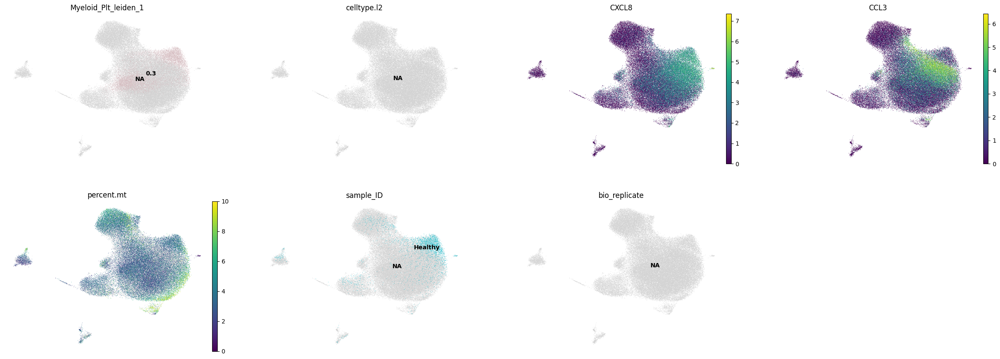

In [30]:
sc.pl.umap(
    adata_list["Myeloid_Plt"],
    color=['Myeloid_Plt_leiden_1','celltype.l2','CXCL8', 'CCL3', 'percent.mt', 'sample_ID', 'bio_replicate'],
    groups=['0.3', 'Healthy'],
    frameon=False,
    legend_loc='on data',
)
plt.show()


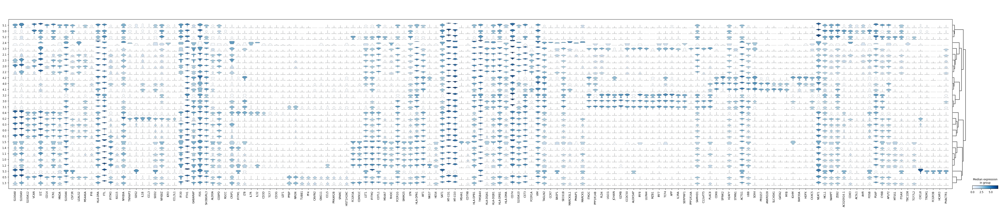

In [31]:
sc.pl.stacked_violin(adata_list["Myeloid_Plt"], pd.unique(top10.values.ravel('K')), groupby='Myeloid_Plt_leiden_1', dendrogram=True)
plt.show()

In [32]:
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"] = adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].astype("str").copy()
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['3.0','3.1','3.2'])]='pDC'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['3.3'])]='ASDC'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['4.0','4.1','4.2'])]='HSPC'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['2.4'])]='cDC1'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['2.0','2.1','2.2','2.3'])]='cDC2'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['1.3'])]='ncMonocyte.Plt.Doublet'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['0.5'])]='cMono.Plt.Doublet'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['0.1','0.0','0.4'])]='cMono'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['5.0','5.1','5.2'])]='cMono'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['1.0','1.1','1.2','1.4','1.5'])]='ncMono'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['5.3'])]='cMono'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_2"].isin(['0.3.1'])]='cMono'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_2"].isin(['0.3.0'])]='cMono'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['0.2'])]='cMono'

adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"] = adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].astype("str").copy()
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['3.0','3.1','3.2'])]='pDC'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['3.3'])]='ASDC'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['4.0','4.1','4.2'])]='HSPC'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['2.4'])]='cDC1'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['2.0','2.1','2.2','2.3'])]='cDC2'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['1.3'])]='ncMonocyte.Plt.Doublet'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['0.5'])]='cMono.Plt.Doublet'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['0.1','0.0','0.4'])]='cMono'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['5.0','5.1','5.2'])]='cMono.ITGAX'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['1.0','1.1','1.2','1.4','1.5'])]='ncMono'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['5.3'])]='cMono.CXCL8hi.CCL3low'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_2"].isin(['0.3.1'])]='cMono.CXCL8hi.CCL3low'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_2"].isin(['0.3.0'])]='cMono'
adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l2"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['0.2'])]='cMono.CXCL8hi.CCL3hi'





/tmp/ipykernel_11821/1071113793.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['3.0','3.1','3.2'])]='pDC'
/tmp/ipykernel_11821/1071113793.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"][adata_list["Myeloid_Plt"].obs["Myeloid_Plt_leiden_1"].isin(['3.3'])]='ASDC'
/tmp/ipykernel_11821/1071113793.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

In [33]:
## find markers for Myeloid_Plt_leiden_1
##rank genes by group then subset top 10   
sc.tl.rank_genes_groups(adata_list["Myeloid_Plt"], 'Myeloid_Plt.annotation.l2')
sc.tl.dendrogram(adata_list["Myeloid_Plt"], groupby='Myeloid_Plt.annotation.l2', use_rep = "X_scVI")
top10 = pd.DataFrame(adata_list["Myeloid_Plt"].uns['rank_genes_groups']['names']).head(10)


/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


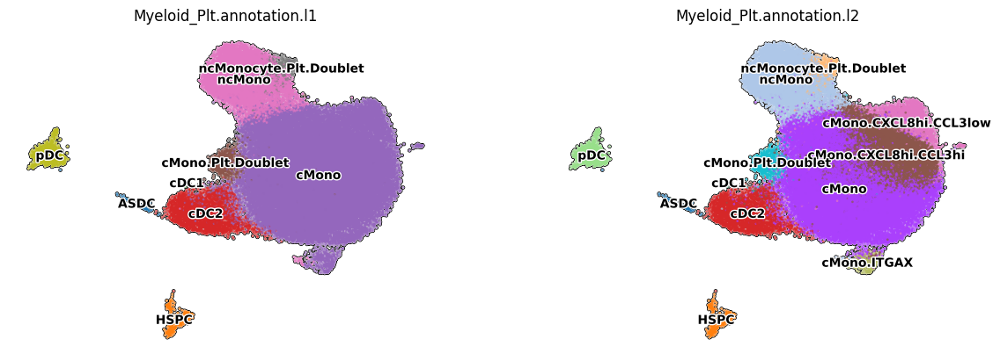

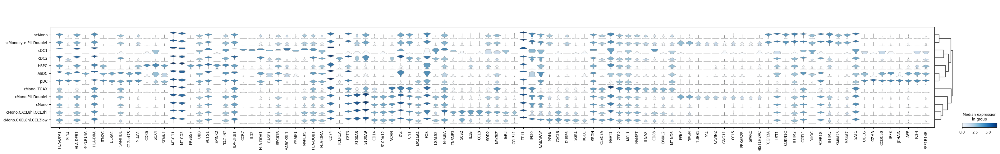

In [34]:
sc.pl.umap(
    adata_list["Myeloid_Plt"],
    color=['Myeloid_Plt.annotation.l1','Myeloid_Plt.annotation.l2'],
    frameon=False,
    legend_loc='on data',
    legend_fontoutline = 2,
    add_outline = True,
    size=15
)

plt.show()


sc.pl.stacked_violin(adata_list["Myeloid_Plt"], pd.unique(top10.values.ravel('K')), groupby='Myeloid_Plt.annotation.l2', dendrogram=True)
plt.show()

In [35]:
## remove doublets
adata_list["Myeloid_Plt"] = adata_list["Myeloid_Plt"][~adata_list["Myeloid_Plt"].obs["Myeloid_Plt.annotation.l1"].isin(["ncMonocyte.Plt.Doublet", "cMono.Plt.Doublet"])].copy()


In [36]:
## Save data
for name, value in adata_list.items():
    cluster_df = pd.DataFrame(adata_list[name].obs[[str(name+".annotation.l1"), str(name+".annotation.l2")]], index=adata_list[name].obs.index)
    # store cluster assignments:
    if os.path.exists(newdata_dir + name +"_clustering_final/") == False:
        os.mkdir(newdata_dir + name +"_clustering_final/")
    
    cluster_df.to_csv(
        os.path.join(newdata_dir + name +"_clustering_final/", f"Peppa_{name}_cluster_assignment.csv")
    )
    
    cluster_scvi = pd.DataFrame(adata_list[name].obsm["X_scVI"], index=adata_list[name].obs_names)
    cluster_umap = pd.DataFrame(adata_list[name].obsm["X_umap"], index=adata_list[name].obs_names)
    # store latent assignments:
    if os.path.exists(newdata_dir + name +"_embeddings/") == False:
        os.mkdir(newdata_dir + name +"_embeddings/")
    
    cluster_scvi.to_csv(
        os.path.join(newdata_dir + name +"_embeddings/", f"Peppa_{name}_scvi.csv")
    )
    cluster_umap.to_csv(
        os.path.join(newdata_dir + name +"_embeddings/", f"Peppa_{name}_umap.csv")
    )





In [ ]:
set(adata_list["Myeloid_Plt"].obs)

In [ ]:
adata_list["Bcells"].obsm["X_umap"].index